
# <div class="alert alert-block alert-info"> <span  style= "font-family: Times New Roman">Categorical Boosting   </span> </div>

## Table of Contents
* [Import necessary libraries](#Import_necessary_libraries)
* [Data loading](#Data_loading)
* [Data Interpretation](#Data_Interpretation)
* [Data preprocessing](#Data_preprocessing)
* [Data Visualization](#Data_Visualization)
    * [Univariate Analysis](#univariate_analysis)
* [Automated EDA](#Automated_EDA)
    * [Dataprep](#dataprep)
    * [Pandas-profiling](#pandas_profiling)
    * [Sweetviz](#sweetviz)
* [Feature Engineering](#Feature_Engineering)
    * [Correlation](#correlation)
    * [Feature Scaling](#Feature_Scaling)
    * [Feature Importance](#Feature_Importance)
        * [Using Decision Tree](#decision_tree)
        * [Using Random Forest](#random_forest)
* [Model Building](#Model_Building)
* [Evaluation metrics](#Evaluation_metrics)
* [Decision boundaries](#Decision_boundaries)
* [Hyperparameter Tuning](#Hyperparameter_Tuning)

**"CatBoost is a high-performance open source library for gradient boosting on decision trees."**

Generally, there are two main `drawbacks of boosting algorithms`:

1. `Overfitting` can easily happen in boosting algorithms because they are tree-based algorithms.
2. It is `not easy to parallelize` the training process of boosting algorithms because new trees are created one after another sequentially.

- So, CatBoost was designed to build more generalized models at lightning-fast speed for large datasets. 
- It has built-in parameters to reduce overfitting and do parallel learning, plus some other unique features! Let’s explore them.

**CatBoost (Categorical Boosting)** is an alternative to XGBoost. It has the following special features:
- Can handle categorical features directly without encoding
- Has simpler hyperparameter tuning process
- Run faster than XGBoost

### Why CatBoost?

Let's see the special features of CatBoost in detail:  <br>
**1.CatBoost has both CPU and GPU support out-of-the-box** <br>
   - task_type: Possible values are “CPU” and “GPU”. <br>
   - devices: This defines the IDs for GPU devices in your computer. The value type is string. You can use numbers such as ‘0’, or ‘1’ to define a single GPU device. To define multiple GPU devices at once, you can use a range of numbers as ‘0:1:2’. <br>
   
**2.We can use categorical features directly with CatBoost** <br>
    - It automatically encodes the categorical features into numeraical features using onehot encoding. <br>
  
  So, If your data has categorical features, you need to convert the entire dataset into CatBoost's special Pool datatype by using the `Pool()` class. <br> If your data has only numerical features, It is recommended not to convert the data into the Pool datatype as this may slow down the training process. So, convert only categorical data. <br>

The following parameter settings in the **`Pool()`** class can be used to include categorical features directly with CatBoost.
- **data:** The feature matrix defined by X. Possible types are Pandas DataFrames or 2D Numpy arrays.
- **label:** The target or label column defined by y. Possible types are Pandas Series or 1D Numpy arrays.
- **cat_features:** A list of categorical feature names in the dataset.

For Example: 
```python
from catboost import CatBoostRegressor, Pool
model = CatBoostRegressor()
pool_data = Pool(X_train,y_train,cat_features=['F1', 'F2', ...])
model.fit(pool_data)
```

Categorical Boosting
- Any format data :Text, Numerical, Categorical
- Loss Function
- Pool: X1,X2,.... Y.... Internal data structure of catboost
- GPU/CPU : Parallel processing

### **CatBoost has built-in parameters to reduce** **`overfitting`**

The following parameters in both CatBoostClassifier() and CatBoostRegressor() classes and their fit() method can be used to reduce the overfitting of the model.

**1. early_stopping_rounds:** This is available in the fit() method of both CatBoostClassifier() and CatBoostRegressor() classes. The default value is False that does not activate early stopping. We can use an integer to stop the learning process early to reduce overfitting. <br>
Early stopping is a special technique that can be used to mitigate overfitting in boosting algorithms. It is used during the training phase of the algorithm. <br>

**`How early stopping works in boosting algorithms?`** <br>
In boosting, a new tree is added in each iteration.The new tree corrects the errors made by the previous trees. <br>
Early stopping stops the training process of the algorithm before the specified boosting rounds given by n_estimators. The stopping point can be monitored by plotting the learning curve. <br>

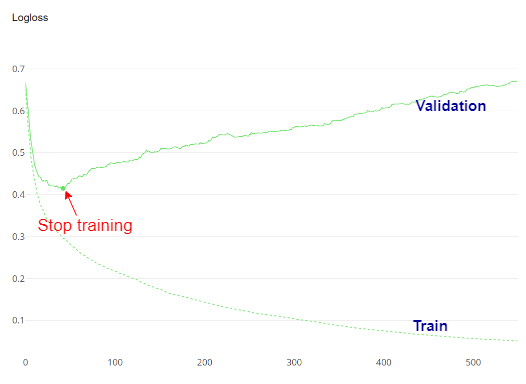

We should understand that when both training scores(RMSE) and validation scores(logloss) are calculated by plotting them against no of boosting rounds. There is a point where validation score stabilizes or starts to getting worse and training error gets increased. This is indication for overfitting. This is where model has to be stopped from further fitting. <br>
Remember, Not every model has the chance of early stopping. 

**2.l2_leaf_reg or reg_lambda:** This is available in both CatBoostClassifier() and CatBoostRegressor() classes. This adds the coefficient of the L2 regularization term to the cost function. The default value is 3. The type is float. Increasing the value prevents overfitting. <br>

**3.depth:** This parameter defines the depth of the tree. This is similar to the max_depth parameter found in decision trees. The default value is 6. The type is integer. Decreasing the value prevents overfitting. Good values are 2 and 3. <br>

### 2. Advantages of CatBoost library <br>
**Performance:** CatBoost provides state of the art results and it is competitive with any leading machine learning algorithm on the performance front.<br>
**Handling Categorical features automatically:** We can use CatBoost without any explicit pre-processing to convert categories into numbers. CatBoost converts categorical values into numbers using various statistics on combinations of categorical features and combinations of categorical and numerical features. <br>
**Robust:** It reduces the need for extensive hyper-parameter tuning and lower the chances of overfitting also which leads to more generalized models. Although, CatBoost has multiple parameters to tune and it contains parameters like the number of trees, learning rate, regularization, tree depth, fold size, bagging temperature and others.

### Additional advantages

**1. CatBoost has a built-in parameter to generate the learning curve** <br>
**2. CatBoost provides great results with its default parameter values** <br>



### <div class="alert alert-block alert-success"> <span  style= "font-family: Times New Roman">**Objective:** Predict the profit for the Customers based on the purchase they make.  </span> </div>

##  <mark> <span  style= "font-family: Times New Roman">Importing necessary  libraries  </span> </mark> <a class="anchor" id="Import_necessary_libraries"></a>

### Lets see the functioning of the algorithm with an example:

Download dataset from here: 
To open this link <a href='https://docs.google.com/spreadsheets/d/1KaNovzOPT-SBd5D5Hac04k0zXEJL5eD_/edit?usp=share_link&ouid=107429087884785471627&rtpof=true&sd=true' title='Google Drive'> Click here

In [3]:
# Basic Python libraries 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
# Getting default style
plt.style.use('fivethirtyeight')

In [5]:
# Import warnings library and ignore them using this filter function
import warnings
warnings.filterwarnings('ignore')

In [6]:
# Plotting in notebook; If it is in colab; define 'colab'
import plotly.io as pio
pio.renderers.default='notebook'

In [7]:
# Import plotly libraries to use more predefined plots and animations
import chart_studio.plotly as py
import plotly.express as px
import plotly.graph_objects as go
# Initiates the plotly interactive notebook mode 
# iplots are interactive plots means zoom,hover,toggle, such interactions can be easily done
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
init_notebook_mode(connected=True)

In [8]:
# Importing libraries for model building
from sklearn.metrics import classification_report,confusion_matrix,precision_score
from sklearn.metrics import recall_score,f1_score,roc_auc_score
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split
from sklearn import metrics

In [9]:
!pip install catboost

In [10]:
# Importing CatBoost Libraries
from catboost import CatBoostRegressor, Pool

## <mark><span  style= "font-family: Times New Roman">Data Loading </span></mark> <a class="anchor" id="Data_loading"></a>

In [11]:
# Reading csv file
df = pd.read_excel('Sample - Superstore.xls')

In [12]:
# Display the data
df.head()

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,Country,City,...,Postal Code,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit
0,1,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,...,42420,South,FUR-BO-10001798,Furniture,Bookcases,Bush Somerset Collection Bookcase,261.9600,2,0.00,41.9136
1,2,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,...,42420,South,FUR-CH-10000454,Furniture,Chairs,"Hon Deluxe Fabric Upholstered Stacking Chairs,...",731.9400,3,0.00,219.5820
2,3,CA-2016-138688,2016-06-12,2016-06-16,Second Class,DV-13045,Darrin Van Huff,Corporate,United States,Los Angeles,...,90036,West,OFF-LA-10000240,Office Supplies,Labels,Self-Adhesive Address Labels for Typewriters b...,14.6200,2,0.00,6.8714
3,4,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,...,33311,South,FUR-TA-10000577,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,5,0.45,-383.0310
4,5,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,...,33311,South,OFF-ST-10000760,Office Supplies,Storage,Eldon Fold 'N Roll Cart System,22.3680,2,0.20,2.5164


In [13]:
df.columns

Index(['Row ID', 'Order ID', 'Order Date', 'Ship Date', 'Ship Mode',
       'Customer ID', 'Customer Name', 'Segment', 'Country', 'City', 'State',
       'Postal Code', 'Region', 'Product ID', 'Category', 'Sub-Category',
       'Product Name', 'Sales', 'Quantity', 'Discount', 'Profit'],
      dtype='object')

##  <mark><span  style= "font-family: Times New Roman">Data preprocessing </span> </mark> <a class="anchor" id="Data_preprocessing"></a>

In [14]:
# Displays rows and columns count
df.shape

(9994, 21)

In [15]:
df.drop_duplicates(inplace=True)

In [16]:
# Counts the sum of all null values for every feature
df.isnull().sum()

Row ID           0
Order ID         0
Order Date       0
Ship Date        0
Ship Mode        0
Customer ID      0
Customer Name    0
Segment          0
Country          0
City             0
State            0
Postal Code      0
Region           0
Product ID       0
Category         0
Sub-Category     0
Product Name     0
Sales            0
Quantity         0
Discount         0
Profit           0
dtype: int64

<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
# Gives all the basic statistical results <br>
# We can observe central tendency features along with standard deviation <br>
# We can also estimate the approximate outlier analysis from this data <br>
</p>
</span>
</div>

In [17]:
df.describe()

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
count,9994.000000,9994.000000,9994.000000,9994.000000,9994.000000,9994.000000
mean,4997.500000,55190.379428,229.858001,3.789574,0.156203,28.656896
std,2885.163629,32063.693350,623.245101,2.225110,0.206452,234.260108
min,1.000000,1040.000000,0.444000,1.000000,0.000000,-6599.978000
25%,2499.250000,23223.000000,17.280000,2.000000,0.000000,1.728750
50%,4997.500000,56430.500000,54.490000,3.000000,0.200000,8.666500
75%,7495.750000,90008.000000,209.940000,5.000000,0.200000,29.364000
max,9994.000000,99301.000000,22638.480000,14.000000,0.800000,8399.976000


In [18]:
# We observe data types of all features and non-null count for every feature
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9994 entries, 0 to 9993
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Row ID         9994 non-null   int64         
 1   Order ID       9994 non-null   object        
 2   Order Date     9994 non-null   datetime64[ns]
 3   Ship Date      9994 non-null   datetime64[ns]
 4   Ship Mode      9994 non-null   object        
 5   Customer ID    9994 non-null   object        
 6   Customer Name  9994 non-null   object        
 7   Segment        9994 non-null   object        
 8   Country        9994 non-null   object        
 9   City           9994 non-null   object        
 10  State          9994 non-null   object        
 11  Postal Code    9994 non-null   int64         
 12  Region         9994 non-null   object        
 13  Product ID     9994 non-null   object        
 14  Category       9994 non-null   object        
 15  Sub-Category   9994 n

#### <mark> These are no missing values as well. So, we need not perform Data Cleaning. </mark>

## <mark> <span  style= " font-family: Times New Roman"> Data Visualization  </span> </mark> <a class="anchor" id="Data_Visualization"></a>

### Lets use `matplotlib`, `seaborn` and `plotly` to perform `EDA` and `Visualization`

### <mark> <span style="color:#FF4701">Univariate Analysis</span> </mark> <a class="anchor" id="univariate_analysis"></a>

In [19]:
# A few color palette for aesthetic plots
# Check out all of them by individually executing them. 
# Remember, aesthetics also add an interesting point for the flow of work.
mesh_1 = ['#AEFFBE','#94FFF1','#FFE48A','#FF9EBE']
sns.color_palette(mesh_1)
colors = ['#FF5851', '#F3C130', '#414A6B', '#B49A85', '#1C1B20']
sns.color_palette(colors)
colors_1 = ['#1D4851','#9AB5BC','#FF9001','#FF4701']
sns.color_palette(colors_1)
colors_2 = ['#0D110F','#6F8C64','#FDD584','#2A4731']
sns.color_palette(colors_2)
colors_3 = ['#0B0B11','#8288C3','#242961','#D0BED4']
sns.color_palette(colors_3)
colors_4 = ['#645CAA','#A084CA','#BFACE0','#EBC7E8']
sns.color_palette(colors_4)

[(0.39215686274509803, 0.3607843137254902, 0.6666666666666666),
 (0.6274509803921569, 0.5176470588235295, 0.792156862745098),
 (0.7490196078431373, 0.6745098039215687, 0.8784313725490196),
 (0.9215686274509803, 0.7803921568627451, 0.9098039215686274)]

In [20]:
df.columns

Index(['Row ID', 'Order ID', 'Order Date', 'Ship Date', 'Ship Mode',
       'Customer ID', 'Customer Name', 'Segment', 'Country', 'City', 'State',
       'Postal Code', 'Region', 'Product ID', 'Category', 'Sub-Category',
       'Product Name', 'Sales', 'Quantity', 'Discount', 'Profit'],
      dtype='object')

In [21]:
# Lets define all the columns into three categories...
# df_categorical, df_numerical, df_removable
df_categorical = df[['Sub-Category', 'Ship Mode','Segment', 'Country', 
                     'City', 'State','Region','Quantity','Category','Sub-Category',]]
df_numerical = df[['Sales', 'Discount', 'Profit']]
df_removable = df[['Row ID', 'Order ID','Customer ID', 'Customer Name','Postal Code','Product Name']]


<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
How many states are there in here?  <br>
</p>
</span>
</div>

In [22]:
# 
no_of_states=df['State'].nunique()
print("There are %d states in this df."%no_of_states)

There are 49 states in this df.


In [23]:
print(df['Sub-Category'].unique())

['Bookcases' 'Chairs' 'Labels' 'Tables' 'Storage' 'Furnishings' 'Art'
 'Phones' 'Binders' 'Appliances' 'Paper' 'Accessories' 'Envelopes'
 'Fasteners' 'Supplies' 'Machines' 'Copiers']



<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
How many sub-categories are there in here?  <br>
</p>
</span>
</div>

In [24]:
no_of_subcategory=df['Sub-Category'].nunique()
print("Categories are divided into %d subcategories"%no_of_subcategory)

Categories are divided into 17 subcategories


In [25]:
df['Segment'].value_counts()

Consumer       5191
Corporate      3020
Home Office    1783
Name: Segment, dtype: int64


<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
Let's create a new Dataframe, where profit is negative which means loss, and concentrate on these areas to improve. <br>
</p>
</span>
</div>

In [26]:
loss_df = df[df['Profit'] < 0]
loss_df.head(2)

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,Country,City,...,Postal Code,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit
3,4,US-2015-108966,2015-10-11,2015-10-18,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,...,33311,South,FUR-TA-10000577,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,5,0.45,-383.031
14,15,US-2015-118983,2015-11-22,2015-11-26,Standard Class,HP-14815,Harold Pawlan,Home Office,United States,Fort Worth,...,76106,Central,OFF-AP-10002311,Office Supplies,Appliances,Holmes Replacement Filter for HEPA Air Cleaner...,68.8100,5,0.80,-123.858


In [27]:
loss_df.shape

(1871, 21)

In [28]:
loss_df.describe()

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
count,1871.000000,1871.000000,1871.000000,1871.000000,1871.000000,1871.000000
mean,5123.965794,55991.122929,250.511574,3.762694,0.480887,-83.448042
std,2929.381441,26041.501999,715.067296,2.141347,0.235080,284.423422
min,4.000000,1841.000000,0.444000,1.000000,0.100000,-6599.978000
25%,2599.000000,33024.000000,12.503000,2.000000,0.200000,-58.660950
50%,5098.000000,60623.000000,71.088000,3.000000,0.400000,-18.088200
75%,7788.000000,77095.000000,284.922000,5.000000,0.700000,-6.261500
max,9963.000000,98198.000000,22638.480000,14.000000,0.800000,-0.089500



<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
Calculate the total loss from the data <br>
</p>
</span>
</div>

In [29]:
Total_loss=np.negative(loss_df['Profit'].sum())
print("Total loss = %.2f" %Total_loss)

Total loss = 156131.29


In [30]:
loss_df.groupby(by='Segment').sum()

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
Segment,,,,,,
Consumer,5101571,57202260,247196.2460,3651,476.76,-84945.7112
Corporate,2927896,30034273,131860.5383,2191,272.00,-44787.2076
Home Office,1557473,17522858,89650.3705,1198,150.98,-26398.3669


In [31]:
loss_df.groupby(by='Sub-Category').sum()

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
Sub-Category,,,,,,
Accessories,499173,5286382,10958.8000,330,18.20,-930.6265
Appliances,355294,4825871,3382.5340,235,53.60,-8629.6412
Binders,3081543,32609300,36140.6130,2456,452.40,-38510.4964
Bookcases,577022,6423506,48072.7408,422,37.99,-12152.2060
Chairs,1235400,15008025,91988.4560,876,61.40,-9880.8413
Fasteners,61455,701930,149.2800,55,2.40,-33.1952
Furnishings,906096,10970913,12845.8440,597,88.60,-6490.9134
Machines,209526,2236261,72456.2530,157,25.60,-30118.6682
Phones,695295,6105294,35797.8400,476,46.60,-7530.6235





<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
- We can observe more loss in the Binders category, machines category, and tables category when compared to other categories. <br>
- Binders are more getting sold. So even giving less discount may lead to vast loss. <br>
- So better to give discounts on which are getting less sold so that even they will start getting sold more. <br> <br>
</p>
</span>
</div>

In [32]:
loss_df['Sub-Category'].value_counts()

Binders        613
Chairs         235
Tables         203
Furnishings    167
Storage        161
Phones         136
Bookcases      109
Accessories     91
Appliances      67
Machines        44
Supplies        33
Fasteners       12
Name: Sub-Category, dtype: int64

In [33]:
loss_df.groupby(by='City').sum().sort_values('Profit',ascending=True).head(10)

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
City,,,,,,
Philadelphia,1209769,4783713,70460.5510,892,115.30,-19590.7411
Houston,985125,14256474,37640.7304,683,104.14,-14785.3668
Chicago,769944,9397492,19910.0120,541,88.20,-11120.6271
San Antonio,172970,2580831,17395.1450,139,17.10,-7831.0254
Lancaster,125296,683904,7699.2420,71,9.40,-7632.4946
Burlington,17091,108868,12044.8740,19,2.00,-5999.3318
Dallas,403004,5487794,9994.0562,280,39.30,-4208.5218
Jacksonville,193591,1237176,31146.2710,154,18.85,-4059.9857
New York City,199903,400828,19533.8020,132,12.20,-3966.0226


In [34]:
loss_df.sort_values(['Sales'],ascending=True).groupby(by='Category').mean()

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
Category,,,,,,
Furniture,5204.096639,59700.907563,361.184295,3.714286,0.367143,-85.344690
Office Supplies,5042.010158,54746.056433,103.395796,3.865688,0.617607,-63.899840
Technology,5180.789668,50287.590406,439.899974,3.553506,0.333579,-142.361322


<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
 While calculating an average, we observed that more loss is in the technology category. <br>
</p>
</span>
</div>

In [35]:
# 10 least sales states
df.groupby(['State']).sum()['Sales'].nsmallest(10)

State
North Dakota             919.910
West Virginia           1209.824
Maine                   1270.530
South Dakota            1315.560
Wyoming                 1603.136
District of Columbia    2865.020
Kansas                  2914.310
Idaho                   4382.486
Iowa                    4579.760
New Mexico              4783.522
Name: Sales, dtype: float64

In [36]:
df.sort_values(['Segment'],ascending=True).groupby('Segment').sum()

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
Segment,,,,,,
Consumer,25581329,288878609,1.161401e+06,19521,820.91,134119.2092
Corporate,15504734,164536330,7.061464e+05,11608,477.85,91979.1340
Home Office,8858952,98157713,4.296531e+05,6744,262.33,60298.6785


In [37]:
# Region wise analysis
df.groupby(by='Region').sum()

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
Region,,,,,,
Central,11685963,151786150,501239.8908,8780,558.34,39706.3625
East,14073919,50171698,678781.2400,10618,414.00,91522.7800
South,8213295,55875052,391721.9050,6209,238.55,46749.4303
West,15971838,293739752,725457.8245,12266,350.20,108418.4489



<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
 Here we can see that sales are less in the South Region. So, to get better profits or more sales we should focus on this area too. <br>
</p>
</span>
</div>


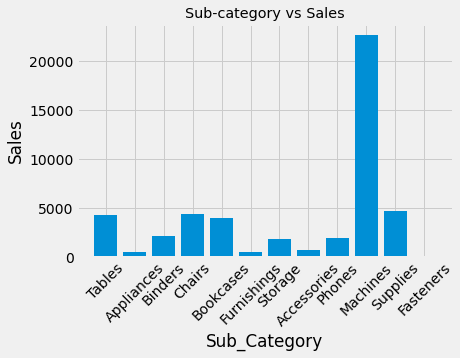

In [38]:
plt.bar(loss_df['Sub-Category'],loss_df['Sales']);
plt.rcParams.update({'font.size':10});
plt.xlabel('Sub_Category');
plt.xticks(rotation = 45)
plt.ylabel('Sales');
plt.title('Sub-category vs Sales')
plt.show()
# we observed that the Sales for Fasteners, Appliances, Furnishings, and Accessories is very low.

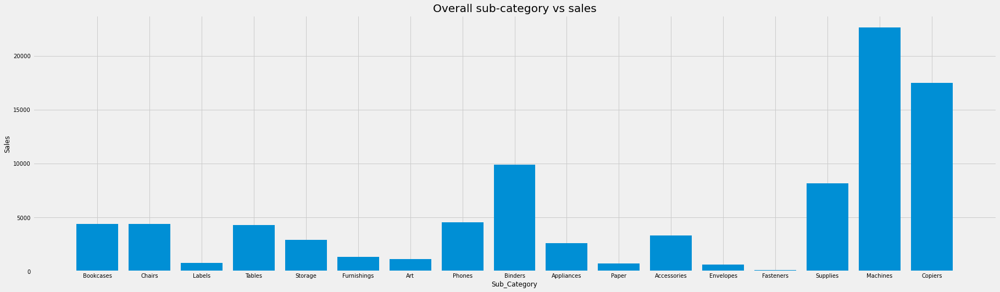

In [39]:
plt.rcParams['figure.figsize']=(28,8)
plt.bar(df['Sub-Category'],df['Sales']);
plt.rcParams.update({'font.size':14});
plt.xlabel('Sub_Category');
plt.ylabel('Sales');
plt.title('Overall sub-category vs sales')
plt.show()
# When it comes to comparison in overall supermarket data, Fasteners, Labels, Furnishings, Art, paper, Envelopes, etc., 
# ......sub-categories have very fewer sales, that’s why it needs to be improved.

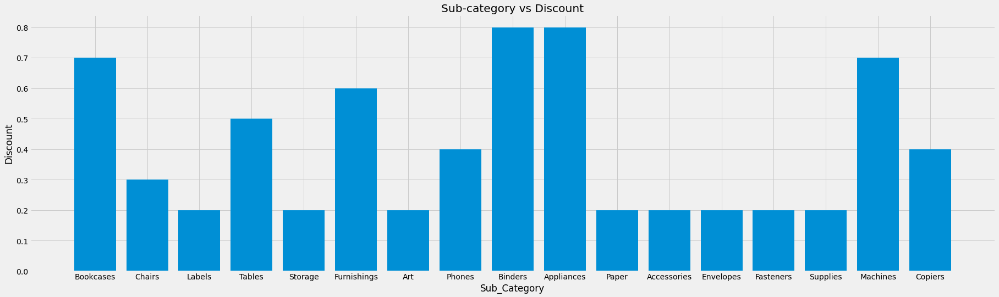

In [40]:
plt.rcParams['figure.figsize']=(28,8)
plt.bar(df['Sub-Category'],df['Discount']);
plt.rcParams.update({'font.size':14});
plt.xlabel('Sub_Category');
plt.ylabel('Discount');
plt.title('Sub-category vs Discount')
plt.show()

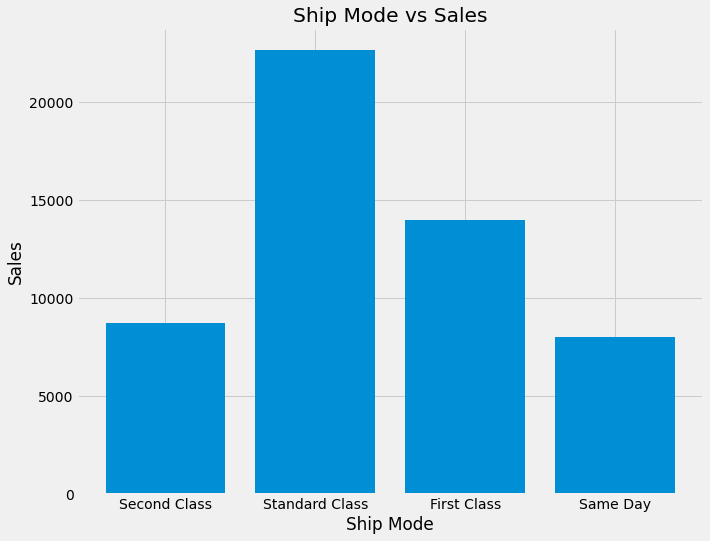

In [41]:
plt.rcParams['figure.figsize']=(10,8)
plt.bar(df['Ship Mode'],df['Sales']);
plt.rcParams.update({'font.size':14});
plt.xlabel('Ship Mode');
plt.ylabel('Sales');
plt.title('Ship Mode vs Sales')
plt.show()

In [42]:
plt.rcParams.update(plt.rcParamsDefault)

In [43]:
# Defining a function to plot Histogram, distribution plot and a boxplot
# Inputting the feature name and the color palette decided above.
def plot_data(column,clr):
    # figsize is given along with the rows=1 and columns=3
    fig,axes = plt.subplots(1,3,figsize=(18,5))
    # super title is given with fontsize
    fig.suptitle(column,fontsize=20,fontstyle='oblique')

    # Histogram is plotted, axes[0] gives the sequential plot number, color is given from the colors list
    sns.histplot(ax=axes[0],x=column,data=df,color=clr[1])
    # Title name is formatted with custom fontsize
    axes[0].set_title('Histogram of {}'.format(column),fontstyle='italic',fontsize=15,color='black')
    #axes[0].set_title('Histogram of {} \n std={:.4f} \n var={:.4f} \n skew={:.4f} \n kurtosis={:.4f}'.format(column,
     #                       df[column].std(),df[column].var(),df[column].skew(),df[column].kurtosis()),fontsize=15)
    
    
    # Distribution plot is plotted with axis label as column name 
    sns.distplot(ax=axes[1],x=df[column],axlabel=column,color=clr[0])
    # Title name of the distribution plot
    axes[1].set_title('Distribution of {}'.format(column),fontstyle='italic',fontsize=15,color='black')

    # Box plot is made to check the Inter Quartile range and the stats inferences
    sns.boxplot(ax=axes[2],x=column,data=df,color=clr[3])
    # Title of box plot is set and there it goes!! 
    axes[2].set_title('Boxplot of {}'.format(column),fontstyle='italic',fontsize=15,color='black')
    plt.show()

In [ ]:
# List of columns to loop the plotting process.
# List of required columns to plot 
cols = df_numerical.columns
#colors = ['colors','colors_1','colors_2','colors_3','colors_4','colors','colors_1','colors_2','colors_3','colors_4','colors','colors_1']
# Starting the for loop for plotting all feature data
for i in range(len(cols)):
    # Plotting the data for each feature with a color palette
    # Also, Take time to analyse each distribution and frame inferences
    # Note the intuition of mean, median and modes along with std, variance, skewness and kurtosis
    plot_data(cols[i],colors_3)

In [45]:
# Lets remove Outliers
print(df['Sales'].quantile(0.8))
print(df['Sales'].quantile(0.9))
print(df['Sales'].quantile(0.95))
print(df['Sales'].quantile(0.98))
print(df['Sales'].quantile(0.99))
print(df['Sales'].max()) # Lets remove 0.02 values of Sales

281.37199999999996
572.7060000000001
956.9842450000002
1641.9669999999946
2481.694599999993
22638.48


In [46]:
# Lets remove Outliers
print(df['Profit'].quantile(0.8))
print(df['Profit'].quantile(0.9))
print(df['Profit'].quantile(0.95))
print(df['Profit'].quantile(0.98))
print(df['Profit'].quantile(0.99))
print(df['Profit'].max()) # Lets remove 0.01 values of Profit

41.0388
89.28162000000006
168.47040000000004
342.27243199999856
580.6578819999994
8399.975999999999


In [47]:
# Selecting values greater than 98% values of Sales and dropping them 
df1 = df[df['Sales']>df['Sales'].quantile(0.98)]
df.drop(df1.index,axis=0,inplace=True)

In [48]:
# Selecting values greater than 98% values of Profit and dropping them 
df2 = df[df['Profit']>df['Profit'].quantile(0.98)]
df.drop(df2.index,axis=0,inplace=True)

In [ ]:
# Replot them to see the change
cols = df_numerical.columns
for i in range(len(cols)):
    plot_data(cols[i],colors_3)

<div class="warning" style='padding:0.1em; background-color:#70A0AF; color:#FFFFFF'>
<span>
<p style='margin-top:1em; text-align:left'>
<b># Conclusions: </b></p>
<p style='margin-left:1em;'>
- We are dealing with three features i.e., Sales, discount, Profit which are primarily numerical<br>
- We can see a skewed(log normal distribution) for Sales, a large set of customers are purchasing for minor charges, a small set of customers are using for higher budgets. Let's check the scope of discounts for this case!!<br>
- For nearly more than 60% customers, there are no discounts given. Very small set of people are given greater than 50%. The discounts also reached 80% maximum expecting that they purchased too higher than the third quartile. <br>
- After eliminating the higher purchases,we have unskewed distribution of Profit in here. It extends upto maximum of 2000. This analysis also explains us that there is significant correlation between the numericla features.
</p>
</span>
</div>

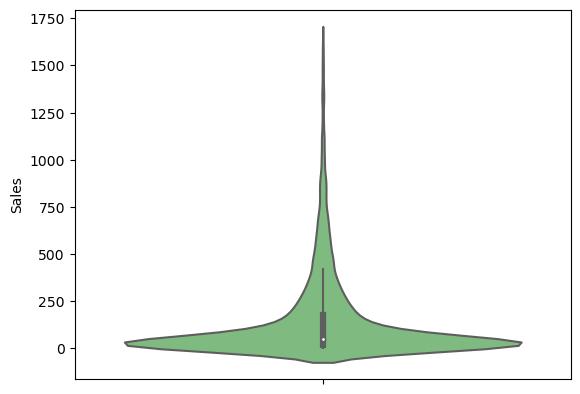

In [50]:
sns.violinplot(data=df,y='Sales',palette='Greens_r')
plt.show()

In [51]:
## Lets plot for categorical columns
#Writing a function to plot the count and pie plot
def plot_data_categorical(column):
    # 1 row and 2 columns subplots definition
    fig,axes = plt.subplots(1,2,figsize=(15,5))
    # Fixing supertitle
    fig.suptitle(column,fontsize=20)
    
    # count plot in first plot with the given column as axes[0]
    sns.countplot(ax=axes[0],x=column,data=df)
    # set the title of the plot
    axes[0].set_title('Count of {}s'.format(column),fontsize=20)
    # If there are more than 5 categories in the column, rotate labels
    if df[column].value_counts().index.size>5:
        # set labels and Rotate labels 
        axes[0].set_xticklabels(labels=df[column].unique(),rotation=90)

    # pie plot in second plot of defined subplots
    axes[1] = plt.pie(df[column].value_counts().values,labels=df[column].value_counts().index,radius=1.2,autopct='%1.2f%%')
    # fix the title of the plot
    plt.title('Count of {}s'.format(column))
    plt.show()

In [ ]:
# plots for categorical columns
cols = df_categorical.columns
for i in range(len(cols)):
    plot_data_categorical(cols[i])

<div class="warning" style='padding:0.1em; background-color:#70A0AF; color:#FFFFFF'>
<span>
<p style='margin-top:1em; text-align:left'>
<b># Conclusions: </b></p>
<p style='margin-left:1em;'>
- There are highest sales for Binders, Paper and Furnishings. Together, they make upto 42% Sales.<br>
- There are very less Sales for Copiers and machines. There may be fixed perspective of Superstore on this for less sales on machines, despite high discounts. <br>
- We have all the orders only from USA. We can get this feature removed. <br>
- We have sales from more than 25 states. Huge number is given from California and Newyork. 
- There is almost equal sales from all directions based on Region which might be geographical coincidence. 
- More than 60% customers are purchasing office items which also validates the first statement. 
</p>
</span>
</div>

In [53]:
plt.style.use('fivethirtyeight')

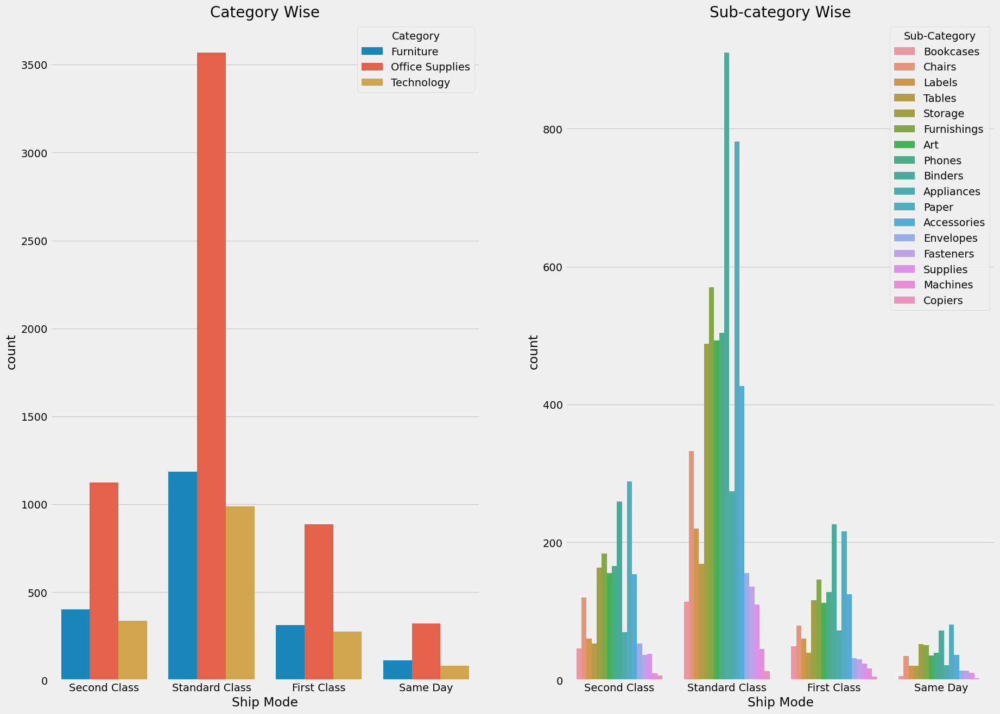

In [54]:
fig, axs = plt.subplots(ncols=2,  figsize = (20,15))
sns.countplot(x="Ship Mode", hue ='Category', data = df,  ax = axs[0])
sns.countplot(x="Ship Mode", hue ='Sub-Category', data = df,  ax = axs[1])
axs[0].set_title('Category Wise', fontsize = 20)
axs[1].set_title('Sub-category Wise', fontsize = 20)
plt.show()

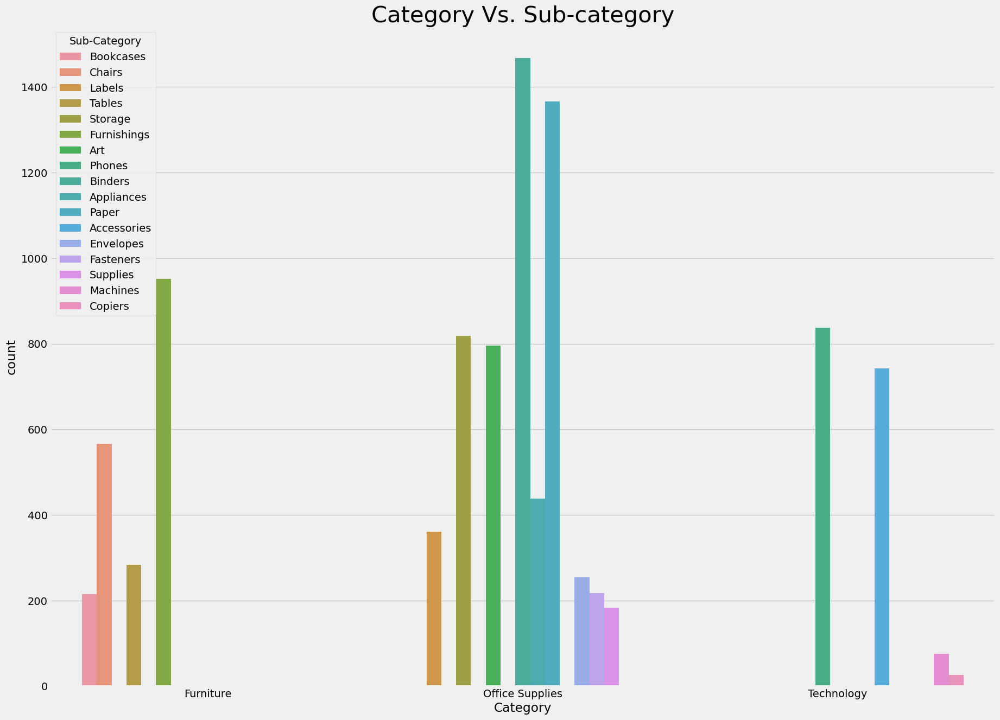

In [55]:
plt.subplots(figsize = (20,15))
sns.countplot(x="Category", hue ='Sub-Category', data = df)
plt.title('Category Vs. Sub-category', fontsize = 30)
plt.show()

<div class="warning" style='padding:0.1em; background-color:#70A0AF; color:#FFFFFF'>
<span>
<p style='margin-top:1em; text-align:left'>
<b># Conclusions: </b></p>
<p style='margin-left:1em;'>
    
- High Demand Products in Different Categories <br>
  - Furniture: Furnishings and Chairs <br>
  - Office Supplies: Binders and Papers <br>
  - Technology: Phones and Accessories <br>
 
- Low Demand Products in Different Categories <br>
  - Furniture: Bookcases and Tables <br>
  - Office Supplies: Fasteners and Supplies <br>
  - Technology: Machines and Copiers <br> 
</p>
</span>
</div>

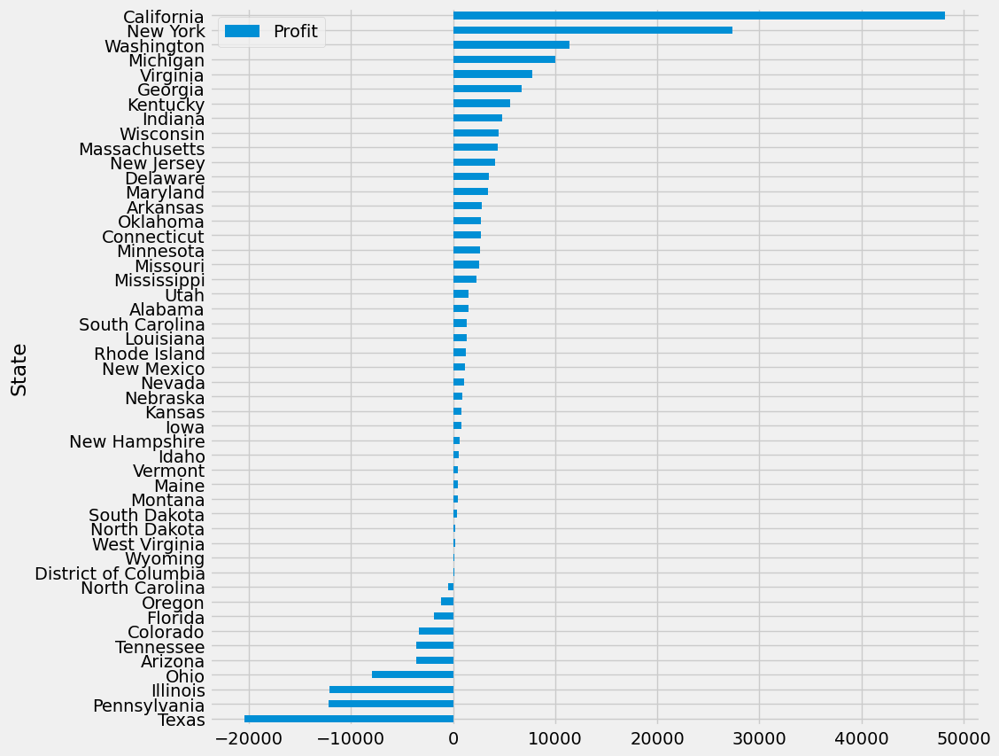

In [56]:
df[['State','Profit']].groupby(['State']).sum().sort_values(by = ['Profit']).plot(kind='barh',figsize=[10,10])
plt.show()

In [57]:
df.columns

Index(['Row ID', 'Order ID', 'Order Date', 'Ship Date', 'Ship Mode',
       'Customer ID', 'Customer Name', 'Segment', 'Country', 'City', 'State',
       'Postal Code', 'Region', 'Product ID', 'Category', 'Sub-Category',
       'Product Name', 'Sales', 'Quantity', 'Discount', 'Profit'],
      dtype='object')

In [59]:
plt.rcParams.update(plt.rcParamsDefault)

In [ ]:
for i in df[['Segment','City','Category','State']]:
    fig10 = px.histogram(data_frame=df,x=i,barmode='group', height=750, width=800,text_auto=True,
                         marginal='violin',labels=i,color_discrete_sequence=colors[2:4],title='{} distribution'.format(i))
    fig10.for_each_annotation(lambda a: a.update(text=a.text.split("=")[1]))
    fig10.show('notebook') # Use fig10.show(renderer='colab') for Google Colab

In [ ]:
from plotly.subplots import make_subplots
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=df_categorical['Ship Mode'].value_counts().index, values=df['Ship Mode'].value_counts(), name="Ship Mode"),1, 1)
fig.add_trace(go.Pie(labels=df_categorical['Segment'].value_counts().index, values=df['Segment'].value_counts(), name="Segment"),1, 2)
fig.update_traces(hole=.4, hoverinfo="label+percent+name", textfont_size=16)
fig.update_layout(title_text="Ship Mode and Segment Distributions",annotations=[dict(text='Ship Mode', x=0.14, y=0.5, font_size=15, showarrow=False),
                 dict(text='Segment', x=0.81, y=0.5, font_size=15, showarrow=False)])
fig.show('notebook') # Use fig.show(renderer='colab') for google colab

In [59]:
# Lets plot for categorical columns first
fig = make_subplots(rows=2, cols=2,
                    subplot_titles=['Region','Category','Segment','Ship Mode'])

fig.add_trace(go.Bar(x=df['Region'].value_counts().index, y=df['Region'].value_counts().values, 
                     text=(df['Region'].value_counts()*100/df['Region'].shape[0]).round(2), width=[1, 1], marker={'color':colors[0]}), row=1, col=1)
fig.add_trace(go.Bar(x=df['Category'].value_counts().index, y=df['Category'].value_counts().values, 
                     text=(df['Category'].value_counts()*100/df['Category'].shape[0]).round(2), width=[0.5, 0.5], marker={'color':colors[1]}), row=1, col=2)
fig.add_trace(go.Bar(x=df['Segment'].value_counts().index, y=df['Segment'].value_counts().values, 
                     text=(df['Segment'].value_counts()*100/df['Segment'].shape[0]).round(2), width=[0.5, 0.5], marker={'color':colors[2]}), row=2, col=1)
fig.add_trace(go.Bar(x=df['Ship Mode'].value_counts().index, y=df['Ship Mode'].value_counts().values, 
                     text=(df['Ship Mode'].value_counts()*100/df['Ship Mode'].shape[0]).round(2), width=[0.5, 0.5], marker={'color':colors[3]}), row=2, col=2)

fig.update_layout(height=750, showlegend=False)
fig.show('notebook') # Use fig.show(renderer='colab') for google colab

In [60]:
df.head(2)

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,Country,City,...,Postal Code,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit
0,1,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,...,42420,South,FUR-BO-10001798,Furniture,Bookcases,Bush Somerset Collection Bookcase,261.96,2,0.0,41.9136
1,2,CA-2016-152156,2016-11-08,2016-11-11,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,...,42420,South,FUR-CH-10000454,Furniture,Chairs,"Hon Deluxe Fabric Upholstered Stacking Chairs,...",731.94,3,0.0,219.5820


### Share of Purchase based on Locations


<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
 Click on the Sunburst plots on the category to see the internal division of the plots. Click on the same to get it back. <br>
</p>
</span>
</div>

In [61]:
fig = px.sunburst(
    data_frame=df,
    path=['Ship Mode','Region','City','State'],  # Root, branches, leaves
    color="Ship Mode",
    color_discrete_sequence=px.colors.qualitative.Pastel,title='Purchase based on Locations')

fig.update_traces(textinfo='label+percent entry')
fig.update_layout(margin=dict(t=0, l=0, r=0, b=0),title_text='Purchase based on Locations')

fig.show('notebook')

### Share of Purchase based on Items

In [62]:
fig = px.sunburst(
    data_frame=df,
    path=['Segment','Category','Sub-Category'],  # Root, branches, leaves
    color="Segment",
    color_discrete_sequence=px.colors.qualitative.Pastel,title='Purchase based on Items')

fig.update_traces(textinfo='label+percent entry')
fig.update_layout(margin=dict(t=0, l=0, r=0, b=0))

fig.show('notebook')

### Share of Purchase based on Sales

In [63]:
fig = px.sunburst(
    data_frame=df,
    path=['Segment','Category','Sub-Category'],  # Root, branches, leaves
    color="Segment",
    color_discrete_sequence=px.colors.qualitative.Pastel,values='Sales')

fig.update_traces(textinfo='label+percent entry')
fig.update_layout(margin=dict(t=0, l=0, r=0, b=0))

fig.show('notebook')

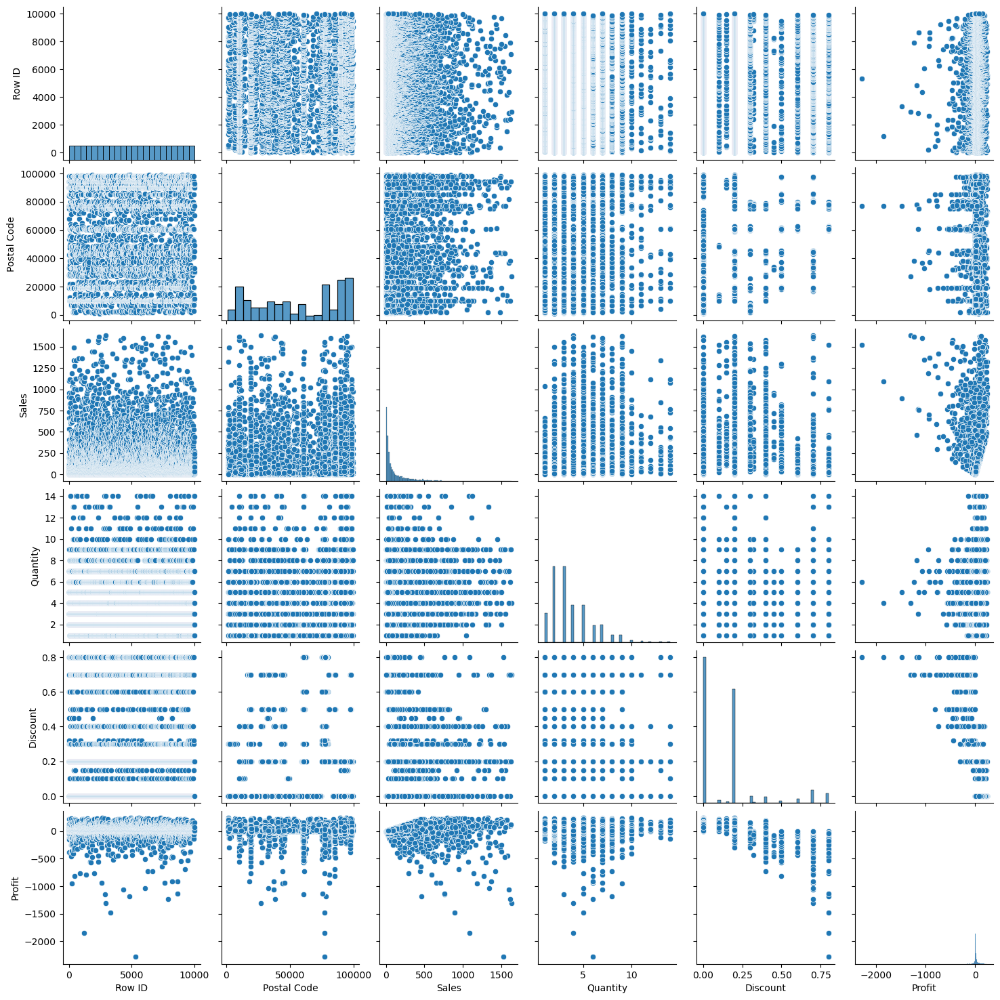

In [64]:
# Lets plot pairplots to understand the feature relations
sns.pairplot(df,palette='RdBu_d')
plt.show()

## <mark> <span style="color:green">Remove unnecessary columns </span> </mark>     <a class="anchor" id="correlation"></a>

In [62]:
df.drop(['Row ID', 'Order ID','Customer ID', 'Customer Name','Country','Postal Code','Product Name'],axis=1,inplace=True)
df.drop('Product ID',axis=1,inplace=True)
df.head(2)

,Order Date,Ship Date,Ship Mode,Segment,City,State,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
0,2016-11-08,2016-11-11,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Bookcases,261.96,2,0.0,41.9136
1,2016-11-08,2016-11-11,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Chairs,731.94,3,0.0,219.5820


## <mark>  <span style="color:darkblue">Automated EDA</span> </mark>     <a class="anchor" id="Automated_EDA"></a>

In [66]:
# Now that we have seen manual plotting and Data preprocessing. Lets see the inferences from automated libraries
# We shall use Dataprep, Pandas-Profiling, Sweetviz libraries now

In [128]:
# Install the below libraries using the below code
# pip install dataprep

<a class="anchor" id="dataprep"></a>

In [1]:
# --> Unhash to run it
# import dataprep
# from dataprep.eda import create_report
# create_report(df)

<a class="anchor" id="pandas_profiling"></a>

In [2]:
# pip install pandas-profiling

<a class="anchor" id="sweetviz"></a>

In [3]:
# pip install sweetviz 

In [4]:
# --> Unhash to run it
# from pandas_profiling import ProfileReport
# profile = ProfileReport(df)
# profile.to_file('output.html')
# profile

In [5]:
# --> Unhash to run it
# import sweetviz as sv
# my_report = sv.analyze(df)
# my_report.show_html() # Default arguments will generate to "SWEETVIZ_REPORT.html"
# check the local depository to open this again

## <mark><span style="color:Purple">Feature Engineering </span> </mark>     <a class="anchor" id="Feature_Engineering"></a>

In [63]:
df.head(2)

,Order Date,Ship Date,Ship Mode,Segment,City,State,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
0,2016-11-08,2016-11-11,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Bookcases,261.96,2,0.0,41.9136
1,2016-11-08,2016-11-11,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Chairs,731.94,3,0.0,219.5820


In [64]:
df.tail(2)

,Order Date,Ship Date,Ship Mode,Segment,City,State,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit
9992,2017-02-26,2017-03-03,Standard Class,Consumer,Costa Mesa,California,West,Office Supplies,Paper,29.60,4,0.0,13.320
9993,2017-05-04,2017-05-09,Second Class,Consumer,Westminster,California,West,Office Supplies,Appliances,243.16,2,0.0,72.948


In [65]:

df['order_month'] = df['Order Date'].dt.month
df['order_date'] = df['Order Date'].dt.day

df['ship_month'] = df['Ship Date'].dt.month
df['ship_date'] = df['Ship Date'].dt.day

### Order Date wise Sales

In [66]:
fig = px.sunburst(
    data_frame=df,
    path=['order_month','order_date'],  # Root, branches, leaves
    color="Segment",
    color_discrete_sequence=px.colors.qualitative.Pastel,values='Sales')

fig.update_traces(textinfo='label+percent entry')
fig.update_layout(margin=dict(t=0, l=0, r=0, b=0))

fig.show('notebook')

### Ship date wise Sales

In [71]:
fig = px.sunburst(
    data_frame=df,
    path=['ship_month','ship_date'],  # Root, branches, leaves
    color="Segment",
    color_discrete_sequence=px.colors.qualitative.Pastel,values='Sales')

fig.update_traces(textinfo='label+percent entry')
fig.update_layout(margin=dict(t=0, l=0, r=0, b=0))

fig.show('notebook')

In [67]:
df.drop(['Order Date','Ship Date'],axis=1,inplace=True)

```python
cat_cols = df.select_dtypes(include = "object").columns.tolist()
df_enc = pd.get_dummies(df[cat_cols], drop_first = False)
enc_columns = df_enc.columns.tolist()
df[enc_columns] = df_enc[enc_columns]
```

In [68]:
df.head(2)

,Ship Mode,Segment,City,State,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit,order_month,order_date,ship_month,ship_date
0,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Bookcases,261.96,2,0.0,41.9136,11,8,11,11
1,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Chairs,731.94,3,0.0,219.5820,11,8,11,11


In [74]:
df.tail(2)

,Ship Mode,Segment,City,State,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit,order_month,order_date,ship_month,ship_date
9992,Standard Class,Consumer,Costa Mesa,California,West,Office Supplies,Paper,29.60,4,0.0,13.320,2,26,3,3
9993,Second Class,Consumer,Westminster,California,West,Office Supplies,Appliances,243.16,2,0.0,72.948,5,4,5,9


## <mark> <span style="color:green">Correlation </span> </mark>     <a class="anchor" id="correlation"></a>

In [78]:
# Style change - Look for more styles - 'ggplot','dark_background','Solarize_Light2','bmh','grayscale' etc..,
plt.style.use('fivethirtyeight')

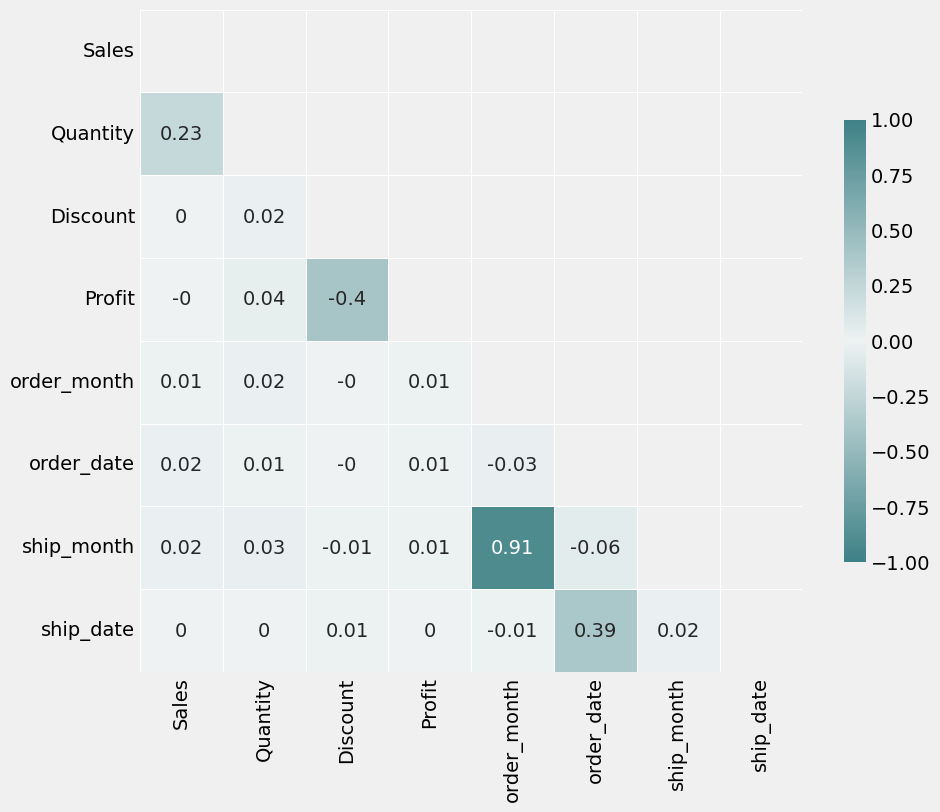

In [201]:
corr = df.corr().round(2)
mask = np.zeros_like(corr,dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
fig11,ax11 = plt.subplots(figsize=(10,10))
cmap = sns.diverging_palette(200,200,as_cmap=True)
sns.heatmap(corr,mask=mask,cmap=cmap,vmin=-1,vmax=1,center=0,square=True,linewidths=.5,cbar_kws={"shrink":0.5},annot=True)
plt.tight_layout()
plt.show()

In [69]:
# Dividing for X,y
X = df.drop('Profit',axis=1)
y = df['Profit']

In [70]:
df.columns

Index(['Ship Mode', 'Segment', 'City', 'State', 'Region', 'Category',
       'Sub-Category', 'Sales', 'Quantity', 'Discount', 'Profit',
       'order_month', 'order_date', 'ship_month', 'ship_date'],
      dtype='object')

## <mark> <span  style= " font-family: Times New Roman"> Model Building  </span> </mark> <a class="anchor" id="Model_Building"></a>

### <mark>Train_test_data split </mark> 

In [71]:
# Splitting the X,y into train and test data
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=10)
print(X_train.shape,X_test.shape,y_train.shape,y_test.shape)

(7678, 14) (1920, 14) (7678,) (1920,)


In [72]:
categorical_features_names = np.where(X.dtypes != float)[0]

In [73]:
categorical_features_names

array([ 0,  1,  2,  3,  4,  5,  6,  8, 10, 11, 12, 13], dtype=int64)

In [74]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9598 entries, 0 to 9993
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Ship Mode     9598 non-null   object 
 1   Segment       9598 non-null   object 
 2   City          9598 non-null   object 
 3   State         9598 non-null   object 
 4   Region        9598 non-null   object 
 5   Category      9598 non-null   object 
 6   Sub-Category  9598 non-null   object 
 7   Sales         9598 non-null   float64
 8   Quantity      9598 non-null   int64  
 9   Discount      9598 non-null   float64
 10  Profit        9598 non-null   float64
 11  order_month   9598 non-null   int64  
 12  order_date    9598 non-null   int64  
 13  ship_month    9598 non-null   int64  
 14  ship_date     9598 non-null   int64  
dtypes: float64(3), int64(5), object(7)
memory usage: 1.2+ MB


In [75]:
#CatBoost
import time
start = time.time()
cb_new = CatBoostRegressor(n_estimators=100,
                       loss_function='RMSE',
                       learning_rate=0.1,
                       depth=3, task_type='CPU',
                       random_state=1,
                       verbose=False)

cb_new.fit(X_train, y_train,cat_features=categorical_features_names)
y_pred = cb_new.predict(X_test)

from sklearn.metrics import mean_squared_error as mse

cb_rmse = np.sqrt(mse(y_test, y_pred))
print("RMSE for CatBoost: ", np.mean(cb_rmse))

end = time.time()
diff = end - start
print('Execution time for CatBoost (in Seconds):', diff)

RMSE for CatBoost:  32.76317637179602
Execution time for CatBoost (in Seconds): 1.1834347248077393


<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
Remember, CatBoost has its own internal feature for plotting learning curve to understand fitting <br>
</p>
</span>
</div>

In [76]:
# Lets first create a basic CatBoost instance and build a model
#The most important parameters are loss_function, n_estimators,depth and learning_rate
# Create CatBoost classifier object with 300 estimators at a learning rate=1
cb = CatBoostRegressor(n_estimators=200,
                       loss_function='RMSE',
                       learning_rate=0.4,
                       depth=3,
                       random_state=1,
                       verbose=False)

pool_train = Pool(X_train, y_train, cat_features = categorical_features_names)
pool_test = Pool(X_test, cat_features = categorical_features_names)

# Train Catboost Classifer
cb.fit(pool_train,plot=True)

#Predict the response for test dataset
y_pred = cb.predict(pool_test)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [77]:
test_pool = Pool(X_test,y_test, cat_features = categorical_features_names)
model = CatBoostRegressor(custom_metric= ['R2', 'RMSE'], learning_rate=0.1, n_estimators=1000)
y_model = model.fit(pool_train, eval_set=test_pool,verbose=100, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 77.4614672	test: 75.7527289	best: 75.7527289 (0)	total: 44.3ms	remaining: 44.3s
100:	learn: 23.7945131	test: 30.1950502	best: 30.1950502 (100)	total: 3.62s	remaining: 32.2s
200:	learn: 20.9257877	test: 29.0548474	best: 29.0548474 (200)	total: 6.91s	remaining: 27.5s
300:	learn: 19.0482150	test: 28.7529952	best: 28.7233170 (285)	total: 10.6s	remaining: 24.7s
400:	learn: 17.5522715	test: 28.6026583	best: 28.5895663 (342)	total: 14.1s	remaining: 21s
500:	learn: 16.2980764	test: 28.5264951	best: 28.5027134 (474)	total: 17.8s	remaining: 17.7s
600:	learn: 15.1825184	test: 28.6163737	best: 28.5027134 (474)	total: 21.2s	remaining: 14.1s
700:	learn: 14.4135890	test: 28.5321039	best: 28.5027134 (474)	total: 24.9s	remaining: 10.6s
800:	learn: 13.5665646	test: 28.5369477	best: 28.5027134 (474)	total: 28.2s	remaining: 7.01s
900:	learn: 12.7556227	test: 28.4672355	best: 28.4579196 (896)	total: 31.5s	remaining: 3.46s
999:	learn: 12.1086265	test: 28.3605890	best: 28.3566635 (992)	total: 34.9s

In [84]:
model.get_best_iteration()

992

In [85]:
dict_results = {'Predicted':y_pred,'Actual':y_test}
results = pd.DataFrame(dict_results)
results

,Predicted,Actual
6733,4.014097,3.2432
9936,48.318402,48.3771
2347,-118.504619,0.0000
9817,8.807473,45.4671
8183,-3.327193,-0.9933
...,...,...
9392,23.636514,-29.1168
5083,17.369534,23.4552
3378,-18.518436,-22.0416
9128,-43.510602,-58.7160



# <div class="alert alert-block alert-success"> <span  style= "font-family: Times New Roman">CatBoost Regressor</span> </div>

In [78]:
# CatBoost
start = time.time()
cb = CatBoostRegressor(n_estimators=1000,
                       loss_function='RMSE',
                       learning_rate=0.1,
                       depth=3,
                       verbose=False)

cb.fit(X_train, y_train,cat_features=categorical_features_names)
y_pred = cb.predict(X_test)

from sklearn.metrics import mean_squared_error as mse

cb_rmse = np.sqrt(mse(y_test, y_pred))
print("RMSE for CatBoost: ", np.mean(cb_rmse))

end = time.time()
diff = end - start
print('Execution time for CatBoost (in Seconds):', diff)

RMSE for CatBoost:  28.60597166770232
Execution time for CatBoost (in Seconds): 12.459295272827148


In [79]:
# We can also plot feature importances using CatBoost model
def plot_feature_importance(importance,names,model_type):
    
    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)
    
    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Define size of bar plot
    plt.figure(figsize=(10,8))
    
    #Plot Searborn bar chart
    sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
    
    #Add chart labels
    plt.title(model_type + ' FEATURE IMPORTANCE')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')

In [ ]:
plot_feature_importance(cb.feature_importances_,X.columns,'CATBOOST')
plt.show()

In [81]:
 cb.feature_importances_

array([ 0.09749893,  0.09760666,  0.09072356,  0.40570899,  0.20171009,
        1.03021108,  8.48001607, 45.84997503,  0.68668951, 42.55384829,
        0.08558002,  0.14208894,  0.10140353,  0.17693931])

## <mark> <span  style= " font-family: Times New Roman"> Evaluation metrics  </span></mark>  <a class="anchor" id="Evaluation_metrics"></a>
     

In [82]:
# Model Mean absolute Error, how often is the classifier correct?
from sklearn.metrics import mean_absolute_error
print("Mean Absolute Error with CatBoost:",mean_absolute_error(y_test, y_pred))

Mean Absolute Error with CatBoost: 12.45546676314751


In [83]:
# Model Mean absolute percentage Error, how often is the classifier correct?
from sklearn.metrics import mean_absolute_percentage_error
print("Mean Absolute Percentage Error with CatBoost:",mean_absolute_percentage_error(y_test, y_pred))

Mean Absolute Percentage Error with CatBoost: 1392152572833611.0


In [84]:
# Model Mean squared Error, how often is the classifier correct?
from sklearn.metrics import mean_squared_error
print("Mean squared Error with CatBoost:",mean_squared_error(y_test, y_pred))

Mean squared Error with CatBoost: 818.3016150533879


In [85]:
print("Root Mean squared Error with CatBoost:",np.sqrt(mean_squared_error(y_test, y_pred)))

Root Mean squared Error with CatBoost: 28.60597166770232


In [86]:
# Calculate R2 score
from sklearn.metrics import r2_score
print("R2 score for this model: ",r2_score(y_test,y_pred))

R2 score for this model:  0.8730466748290591


##  <mark> <span  style= " font-family: Times New Roman"> Hyperparameter tuning  </span></mark> <a class="anchor" id="Hyperparameter_Tuning"></a>

In [87]:
df.head(2)

,Ship Mode,Segment,City,State,Region,Category,Sub-Category,Sales,Quantity,Discount,Profit,order_month,order_date,ship_month,ship_date
0,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Bookcases,261.96,2,0.0,41.9136,11,8,11,11
1,Second Class,Consumer,Henderson,Kentucky,South,Furniture,Chairs,731.94,3,0.0,219.5820,11,8,11,11



<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
Here's a simple function that tests CatBoost performance on 3-fold cross-validation given the parameters and returns the full list of parameters for the last model. This function compares the model's metrics with the results of the model trained with the default categorical features parameters. <br> We will fix the number of estimators at 1500 and the learning rate at 0.1.
</p>
</span>
</div>

In [ ]:
from catboost import CatBoost
from sklearn.model_selection import KFold
# Writing no of folds wiht shuffling
kf = KFold(n_splits=3, shuffle=True)
# these are the two default parameters we will be considering
DEFAULT_PARAMETERS = {'n_estimators' : 4500, 'learning_rate' : 0.1}
# Lets further define the metrics
DEFAULT_MODEL_METRICS = {}

# Defining the scoring function
def score_catboost_model(catboost_parameters, update_defaults=False):
    # A list to append all r2_values
    r2_values = []
    # A list to append all rmse_values
    rmse_values = []
    # updating the parameters using the default update function here
    catboost_parameters.update(DEFAULT_PARAMETERS)
    # For evry index in the kf operation of the dataframe
    for train_index, test_index in kf.split(df):
        # For every index we shall take this train and test pool for easy and parallel processing 
        train_pool = Pool(df.iloc[train_index].drop(['Profit'], 1),
                          label=df.iloc[train_index].Profit,
                          cat_features=categorical_features_names)
        test_pool = Pool(df.iloc[test_index].drop(['Profit'], 1),
                        label=df.iloc[test_index].Profit,
                        cat_features=categorical_features_names)
        # building a model with updated parameters
        model = CatBoost(catboost_parameters)
        # fit the model with the defined pool structure
        model.fit(train_pool, verbose=False)
        
        # Appending the metric values to the respective lists
        # Calculating the r2 score for the predicted and actual values and append it
        r2_values.append(r2_score(df.iloc[test_index].Profit.values, model.predict(test_pool)))
        # Calculating the rmse score for the predicted and actual values and append it
        rmse_values.append(mean_squared_error(df.iloc[test_index].Profit.values,
                                              model.predict(test_pool),
                                              squared=False)) 
    # If there is default updations 
    if update_defaults:
        # add it to the previously defined dictionary with r2
        DEFAULT_MODEL_METRICS['R2'] = np.mean(r2_values)
        # add it to the previously defined dictionary with rmse
        DEFAULT_MODEL_METRICS['RMSE'] = np.mean(rmse_values)
        # Print both the values mean and standard deviation
        print('R2 score: {:.4f}({:.4f})'.format(np.mean(r2_values), np.std(r2_values)))
        print('RMSE score: {:.0f}({:.0f})'.format(np.mean(rmse_values), np.std(rmse_values)))  

    # In the other case, consider the previous iteration values
    else:
        # add the r2_score and rmse values
        DEFAULT_MODEL_R2 = DEFAULT_MODEL_METRICS['R2']
        DEFAULT_MODEL_RMSE = DEFAULT_MODEL_METRICS['RMSE']
        # Calculate the change in the average and the default model metric values
        r2_change = 100 * (np.mean(r2_values) - DEFAULT_MODEL_R2) / DEFAULT_MODEL_R2
        rmse_change = 100 * (np.mean(rmse_values) - DEFAULT_MODEL_RMSE) / DEFAULT_MODEL_RMSE
        print('R2 score: {:.4f}({:.4f}) {:+.1f}% compared to default parameters'.format(
            np.mean(r2_values), np.std(r2_values), r2_change))
        print('RMSE score: {:.0f}({:.0f}) {:+.1f}% compared to default parameters'.format(
            np.mean(rmse_values), np.std(rmse_values), rmse_change))  
        
    return model.get_all_params()

In [89]:
# Calculating for default parameters
last_model_params = score_catboost_model({}, True)

R2 score: 0.8618(0.0136)
RMSE score: 30(3)


In [90]:
### One Hot-Encoding Max size; default 
model_params = score_catboost_model({'one_hot_max_size' : 2000})

R2 score: 0.8743(0.0077) +1.5% compared to default parameters
RMSE score: 29(2) -4.6% compared to default parameters


<div class="warning" style='padding:0.1em; background-color:#69337A; color:#FFFFFF'>
<span>
<p style='margin-top:1em; text-align:left'>
<b># Speed up the training: </b></p>
<p style='margin-left:1em;'>
- Training on GPU:  <br>
    - If the dataset is large enough, training on GPU gives a significant speedup compared to training on CPU. The larger the dataset, the more significant is the speedup. For example, the speedup for training on datasets with millions of objects on Volta GPUs is around 40-50 times. <br>

- Iterations and learning rate: <br>
    - Decrease the learning rate if overfitting is observed. <br>
    - Increase the learning rate if there is no overfitting and the error on the evaluation dataset still reduces on the last iteration. <br>

- Bootstrap type:  <br>
    - By default, the method for sampling the weights of objects is set to . The training is performed faster if the method is set and the value for the sample rate for bagging is smaller than 1. <br>
    
- One-hot encoding: <br>
    - Using One-hot encoding in prior to reduce time. <br>
    
- Leaf estimation iterations: <br>
    - Try setting the value to 1 or 5 to speed up the training on datasets with a small number of features. <br>

- Number of categorical features to combine: <br>
    - Try turning off the generation of categorical feature combinations or limiting the number of categorical features that can be combined to two to speed up the training.<br>
    
- Reusing quantized datasets in Python: <br>
    - By default, the train and test datasets are quantized each time that the boosting is run. <br>
    - If the dataset and quantization parameters are the same across multiple runs, the total wall clock time can be reduced by saving and reusing the quantized dataset. This optimization is `applicable only for datasets without categorical features.` <br>
</p>
</span>
</div>

### Simple grid search

In [ ]:
import catboost
model_1 = catboost.CatBoostRegressor(
    iterations=1000)
grid = {
    'learning_rate': [0.05, 0.1],
    'depth':[4, 6]
}
grid_search_results = model_1.grid_search(grid,pool_train, shuffle=False, verbose=False, plot=True)
# Parameters shown here are for understanding. Modify them based on results. 

<div class="warning" style='padding:0.1em; background-color:#E9D8FD; color:#69337A'>
<span>
<p style='margin-left:1em;'>
Parameters giving the best parameters in grid results
</p>
</span>
</div>

In [95]:
grid_search_results['params']

{'depth': 6, 'learning_rate': 0.1}

In [96]:
grid_search_results['cv_results'].keys()

dict_keys(['iterations', 'test-RMSE-mean', 'test-RMSE-std', 'train-RMSE-mean', 'train-RMSE-std'])

In [98]:
predicted = model_1.predict(pool_test)
predicted[:3]

array([   1.7666992 ,   47.65899183, -105.12500359])

In [ ]:
fig = go.Figure()
fig.update_layout(title={'text': "Actual vs Predicted Results", 'x':0.4})

fig.add_trace(go.Bar(
    y=y_test[:],
    name='Actual',
    marker_color='black', opacity=0.5))
fig.add_trace(go.Bar(
    y=y_pred[:],
    name='Predicted',
    marker_color='darkred', opacity=0.3))
fig.update_layout(barmode='overlay', xaxis_tickangle=-45)
fig.show()